<h1><center>E-Commerce Segmentation </center></h1>
Here you would need to create a model which assigns a customer to a certain customer category based on the total value of orders they’ve placed. This would let us target the most valuable customers with certain offers which promote a higher spend. 
The dataset is a CSV, where each row represents an sku which is a part of an order. The different columns are described below. Every conversation included has at least one request from a consumer and at least one response from a company. Which user IDs are company user IDs can be calculated using the inbound field.

#### Content
***InvoiceNo*** </br>
A single invoice number represents one order that was placed. There might be multiple rows for the same invoice number, representing the different SKUs that were ordered.

**StockCode** </br>
This represents the sku for the particular item that was ordered.

**Description** </br>
This describes the exact item that was ordered in words.

**Quantity** </br>
The quantity of the specific sku that was ordered.

**InvoiceDate** </br>
This is the date the order was placed.

**UnitPrice** </br>
This is the price of the particular sku that was ordered.

**CustomerID** </br>
An anonymized ID of the customer who placed the order.


# 1. Overview and understanding of data

In [1]:
# Importing Libraries
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go


# K-means clustering libraries
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

# hierarchical Clustering libraries
from scipy.cluster.hierarchy import linkage
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster.hierarchy import cut_tree
%matplotlib inline

import warnings
warnings.simplefilter(action='ignore')
plt.style.use('seaborn')
import plotly.express as px

In [2]:
# load the data
df = pd.read_csv('data.csv',header= 0,encoding= 'unicode_escape')
df.head(10)

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,12/1/2010 8:26,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,12/1/2010 8:26,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,12/1/2010 8:26,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,12/1/2010 8:26,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,12/1/2010 8:26,3.39,17850.0,United Kingdom
5,536365,22752,SET 7 BABUSHKA NESTING BOXES,2,12/1/2010 8:26,7.65,17850.0,United Kingdom
6,536365,21730,GLASS STAR FROSTED T-LIGHT HOLDER,6,12/1/2010 8:26,4.25,17850.0,United Kingdom
7,536366,22633,HAND WARMER UNION JACK,6,12/1/2010 8:28,1.85,17850.0,United Kingdom
8,536366,22632,HAND WARMER RED POLKA DOT,6,12/1/2010 8:28,1.85,17850.0,United Kingdom
9,536367,84879,ASSORTED COLOUR BIRD ORNAMENT,32,12/1/2010 8:34,1.69,13047.0,United Kingdom


In [3]:
df.tail(10)

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
541899,581587,22726,ALARM CLOCK BAKELIKE GREEN,4,12/9/2011 12:50,3.75,12680.0,France
541900,581587,22730,ALARM CLOCK BAKELIKE IVORY,4,12/9/2011 12:50,3.75,12680.0,France
541901,581587,22367,CHILDRENS APRON SPACEBOY DESIGN,8,12/9/2011 12:50,1.95,12680.0,France
541902,581587,22629,SPACEBOY LUNCH BOX,12,12/9/2011 12:50,1.95,12680.0,France
541903,581587,23256,CHILDRENS CUTLERY SPACEBOY,4,12/9/2011 12:50,4.15,12680.0,France
541904,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,12/9/2011 12:50,0.85,12680.0,France
541905,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,12/9/2011 12:50,2.10,12680.0,France
541906,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,12/9/2011 12:50,4.15,12680.0,France
541907,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,12/9/2011 12:50,4.15,12680.0,France
541908,581587,22138,BAKING SET 9 PIECE RETROSPOT,3,12/9/2011 12:50,4.95,12680.0,France


# 2. Data Cleaning
Data format cleaning

In [4]:
# give the sum info about data columns typenull values
df.shape

(541909, 8)

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 541909 entries, 0 to 541908
Data columns (total 8 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   InvoiceNo    541909 non-null  object 
 1   StockCode    541909 non-null  object 
 2   Description  540455 non-null  object 
 3   Quantity     541909 non-null  int64  
 4   InvoiceDate  541909 non-null  object 
 5   UnitPrice    541909 non-null  float64
 6   CustomerID   406829 non-null  float64
 7   Country      541909 non-null  object 
dtypes: float64(2), int64(1), object(5)
memory usage: 33.1+ MB


In [6]:
null_values = df.isnull().sum()
null_perc = df.isnull().sum()*100/len(df)
a = '='*50
print(f"{null_values} \n{a} \n {null_perc}")

InvoiceNo           0
StockCode           0
Description      1454
Quantity            0
InvoiceDate         0
UnitPrice           0
CustomerID     135080
Country             0
dtype: int64 
 InvoiceNo       0.000000
StockCode       0.000000
Description     0.268311
Quantity        0.000000
InvoiceDate     0.000000
UnitPrice       0.000000
CustomerID     24.926694
Country         0.000000
dtype: float64


The 25% of **CustemerID** entries are not assigned to a particular customer</br>
So we need to **delete** them from the dataframe

In [7]:
df = df.dropna() #remove all the NaN values
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 406829 entries, 0 to 541908
Data columns (total 8 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   InvoiceNo    406829 non-null  object 
 1   StockCode    406829 non-null  object 
 2   Description  406829 non-null  object 
 3   Quantity     406829 non-null  int64  
 4   InvoiceDate  406829 non-null  object 
 5   UnitPrice    406829 non-null  float64
 6   CustomerID   406829 non-null  float64
 7   Country      406829 non-null  object 
dtypes: float64(2), int64(1), object(5)
memory usage: 27.9+ MB


### Generating 'Amount' column using 'Quantity' & 'UnitPrice'

In [8]:
df['Amount'] = df['Quantity'] * df['UnitPrice']
df.head(10)

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,Amount
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,12/1/2010 8:26,2.55,17850.0,United Kingdom,15.30
1,536365,71053,WHITE METAL LANTERN,6,12/1/2010 8:26,3.39,17850.0,United Kingdom,20.34
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,12/1/2010 8:26,2.75,17850.0,United Kingdom,22.00
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,12/1/2010 8:26,3.39,17850.0,United Kingdom,20.34
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,12/1/2010 8:26,3.39,17850.0,United Kingdom,20.34
5,536365,22752,SET 7 BABUSHKA NESTING BOXES,2,12/1/2010 8:26,7.65,17850.0,United Kingdom,15.30
6,536365,21730,GLASS STAR FROSTED T-LIGHT HOLDER,6,12/1/2010 8:26,4.25,17850.0,United Kingdom,25.50
7,536366,22633,HAND WARMER UNION JACK,6,12/1/2010 8:28,1.85,17850.0,United Kingdom,11.10
8,536366,22632,HAND WARMER RED POLKA DOT,6,12/1/2010 8:28,1.85,17850.0,United Kingdom,11.10
9,536367,84879,ASSORTED COLOUR BIRD ORNAMENT,32,12/1/2010 8:34,1.69,13047.0,United Kingdom,54.08


In [9]:
#  The description column will be converter into lower case.
df['Description']=df.Description.str.lower()

In [10]:
df['CustomerID'] = df['CustomerID'].astype('int')
df['InvoiceDate'] = pd.to_datetime(df['InvoiceDate'],infer_datetime_format=True)

In [11]:
df.describe()

,Quantity,UnitPrice,CustomerID,Amount
count,406829.000000,406829.000000,406829.000000,406829.000000
mean,12.061303,3.460471,15287.690570,20.401854
std,248.693370,69.315162,1713.600303,427.591718
min,-80995.000000,0.000000,12346.000000,-168469.600000
25%,2.000000,1.250000,13953.000000,4.200000
50%,5.000000,1.950000,15152.000000,11.100000
75%,12.000000,3.750000,16791.000000,19.500000
max,80995.000000,38970.000000,18287.000000,168469.600000


## Add the columns - Month, Day and Hour for the invoice

The column related to the transaction date will be converted from 'object' (a simple string basically) to the very convenient date format "date-time" in pandas.

In [12]:
# change the invoice_date format - String to Timestamp format
df['InvoiceDate'] = pd.to_datetime(df.InvoiceDate, format='%m/%d/%Y %H:%M')

In [13]:
df.insert(loc=2, column='Year_Month', value=df['InvoiceDate'].map(lambda x: 100*x.year + x.month))

df.insert(loc=3, column='Month', value=df.InvoiceDate.dt.month)

# +1 to make Monday=1.....until Sunday=7

df.insert(loc=4, column='Day', value=(df.InvoiceDate.dt.dayofweek)+1)

df.insert(loc=5, column='Hour', value=df.InvoiceDate.dt.hour)

In [14]:
# Now check duplicate entries and delete them
print(f"No of Duplicates in data is : {df.duplicated().sum()}")
df.drop_duplicates(inplace = True)

No of Duplicates in data is : 5225


### Canceled orders analysis

In [15]:
# Quantity has negative values and unit price has a minimum value of 0
np.sum(df['Quantity']<0)

8872

There are **8872** transactions with negative quantity. We will investigate if they are related to canceled orders or mistakes.

In [16]:
canceled_orders = df[df['InvoiceNo'].apply(lambda x: x[0]=='C')]
canceled_orders.head()

,InvoiceNo,StockCode,Year_Month,Month,Day,Hour,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,Amount
141,C536379,D,201012,12,3,9,discount,-1,2010-12-01 09:41:00,27.50,14527,United Kingdom,-27.50
154,C536383,35004C,201012,12,3,9,set of 3 coloured flying ducks,-1,2010-12-01 09:49:00,4.65,15311,United Kingdom,-4.65
235,C536391,22556,201012,12,3,10,plasters in tin circus parade,-12,2010-12-01 10:24:00,1.65,17548,United Kingdom,-19.80
236,C536391,21984,201012,12,3,10,pack of 12 pink paisley tissues,-24,2010-12-01 10:24:00,0.29,17548,United Kingdom,-6.96
237,C536391,21983,201012,12,3,10,pack of 12 blue paisley tissues,-24,2010-12-01 10:24:00,0.29,17548,United Kingdom,-6.96


By analyzing the first 5 values of the dataframe we can see that the quantity has a negative values, is this true for all canceled orders?

In [17]:
print(f'The percentage of canceled orders is: {round(canceled_orders.shape[0]/df.shape[0]*100,2)}')

The percentage of canceled orders is: 2.21


Now, all the canceled orders will be dropped.

In [18]:
df = df[df['Quantity'] > 0]
df.sort_values(by='StockCode', ascending=False, inplace=True)
df.head()

,InvoiceNo,StockCode,Year_Month,Month,Day,Hour,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,Amount
299512,563100,POST,201108,8,5,9,postage,6,2011-08-12 09:57:00,40.0,12381,Norway,240.0
224432,556526,POST,201106,6,1,11,postage,1,2011-06-13 11:33:00,18.0,12732,France,18.0
186640,552874,POST,201105,5,4,9,postage,7,2011-05-12 09:40:00,18.0,12621,Germany,126.0
103055,545051,POST,201102,2,7,11,postage,1,2011-02-27 11:58:00,18.0,12599,France,18.0
477044,577046,POST,201111,11,4,13,postage,7,2011-11-17 13:46:00,18.0,12449,Belgium,126.0


In [19]:
uk_ecom = df[df['Country']=='United Kingdom']
uk_ecom['Description'] = uk_ecom['Description'].astype(str)
freq = pd.Series(' '.join(uk_ecom['Description']).split()).value_counts()[:20]
freq

of           35062
set          34281
bag          33304
heart        26985
red          26699
vintage      22739
retrospot    21997
design       20429
pink         17481
christmas    17355
box          15197
white        14851
metal        14737
jumbo        14128
cake         13607
lunch        12708
3            12541
blue         12107
sign         12010
hanging      11952
dtype: int64

## 3. Exploratory Data Analysis (EDA)
### How many orders made by the customers?

In [20]:
df.groupby(by=['CustomerID','Country'], as_index=False)['InvoiceNo'].count().head()

,CustomerID,Country,InvoiceNo
0,12346,United Kingdom,1
1,12347,Iceland,182
2,12348,Finland,31
3,12349,Italy,73
4,12350,Norway,17


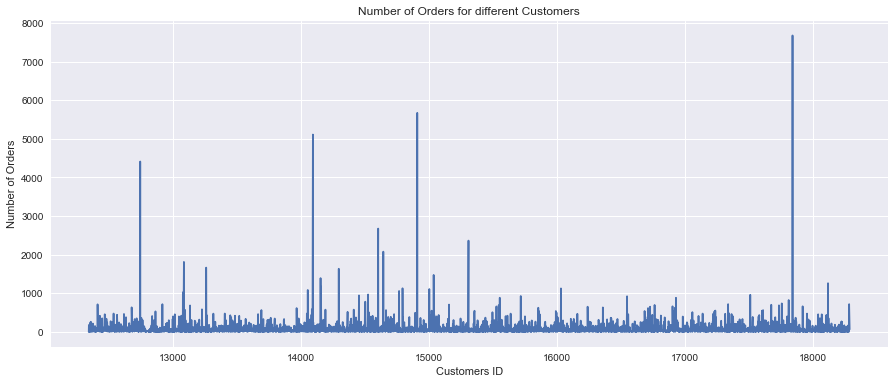

In [21]:
orders = df.groupby(by=['CustomerID','Country'], as_index=False)['InvoiceNo'].count()

plt.figure(figsize=(15,6))
plt.plot(orders.CustomerID, orders.InvoiceNo)
plt.xlabel('Customers ID')
plt.ylabel('Number of Orders')
plt.title('Number of Orders for different Customers')
plt.show()

##### We can see there was few customer they order in bulk

In [22]:
# Checking categorical data from df.Country

country_set = df[['Country', 'InvoiceNo']]
country_set = country_set.pivot_table(columns='Country', aggfunc='count')   #https://pandas.pydata.org/docs/reference/api/pandas.pivot_table.html
country_set.sort_values('InvoiceNo', axis=1, ascending=False).T

,InvoiceNo
Country,
United Kingdom,349227
Germany,9027
France,8327
EIRE,7228
Spain,2480
Netherlands,2363
Belgium,2031
Switzerland,1842
Portugal,1453


### Check TOP 5 most number of orders by Country

In [23]:
print('The TOP 5 customers with most number of orders...')
top = orders.sort_values(by='InvoiceNo', ascending=False).head()
top = pd.DataFrame(top)
top

The TOP 5 customers with most number of orders...


,CustomerID,Country,InvoiceNo
4019,17841,United Kingdom,7676
1888,14911,EIRE,5672
1298,14096,United Kingdom,5111
334,12748,United Kingdom,4413
1670,14606,United Kingdom,2677


### How many orders (per month)?

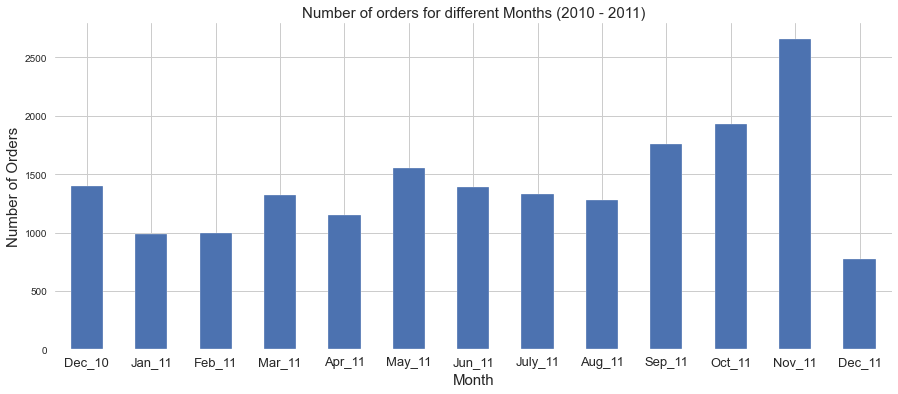

In [66]:
ax = df.groupby('InvoiceNo')['Year_Month'].unique().value_counts().sort_index().plot(kind ='bar',figsize=(15,6))
ax.set_xlabel('Month',fontsize=15)
ax.set_ylabel('Number of Orders',fontsize=15)
ax.set_title('Number of orders for different Months (2010 - 2011)',fontsize=15)
ax.set_xticklabels(('Dec_10','Jan_11','Feb_11','Mar_11','Apr_11','May_11','Jun_11','July_11','Aug_11','Sep_11','Oct_11','Nov_11','Dec_11'), rotation='horizontal', fontsize=13)
plt.show()

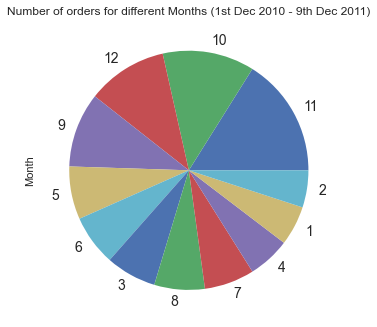

In [25]:
# https://pandas.pydata.org/pandas-docs/version/0.23/generated/pandas.DataFrame.plot.html
df.Month.value_counts().plot(kind='pie',fontsize=14,
                             title='Number of orders for different Months (1st Dec 2010 - 9th Dec 2011)')
plt.show()

### Observation :
 - We can observe that most sales happended in November month
 - Most sales happedned in the end of year and maybe it's because of christmas


## How many orders (per day)?

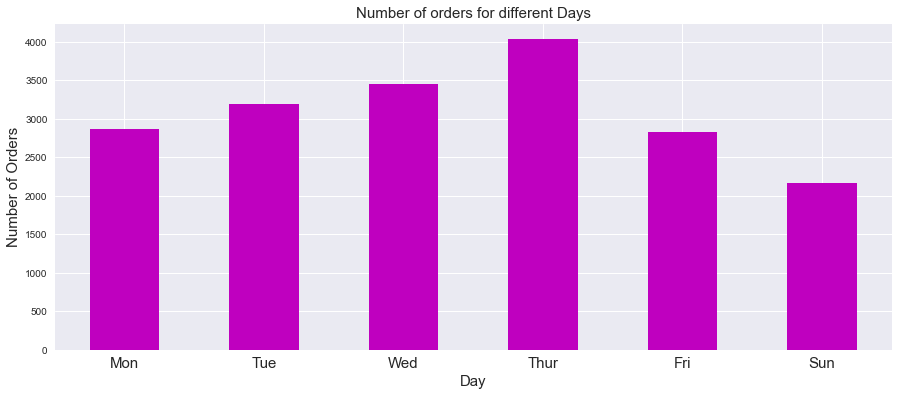

In [26]:
ax = df.groupby('InvoiceNo')['Day'].unique().value_counts().sort_index().plot(kind='bar',color='medal'[0],figsize=(15,6))
ax.set_xlabel('Day',fontsize=15)
ax.set_ylabel('Number of Orders',fontsize=15)
ax.set_title('Number of orders for different Days',fontsize=15)
ax.set_xticklabels(('Mon','Tue','Wed','Thur','Fri','Sun'), rotation='horizontal', fontsize=15)
plt.show()

### Revenue and Quantity by Sale Daywise

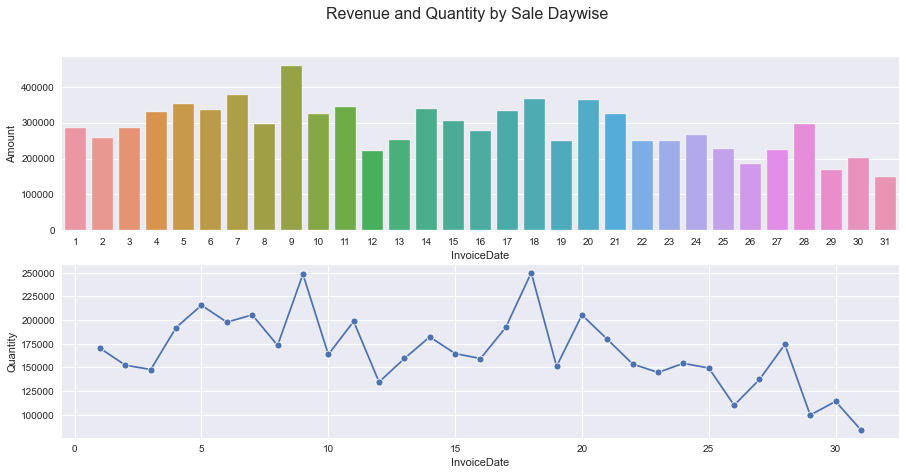

In [27]:
fig, ax = plt.subplots(nrows=2, ncols=1,figsize=(15,7))
sns.set_style("whitegrid")

date = df[df['Amount']>=0][['InvoiceDate','Amount','Quantity']]
date = date.groupby(date['InvoiceDate'].dt.day)[['Amount','Quantity']].sum()

sns.barplot(data = date, x=date.index, y='Amount', alpha=1, ax=ax[0])
sns.lineplot(data = date, x=date.index, y='Quantity', marker='o', sort = False, ax=ax[1])
fig.suptitle('Revenue and Quantity by Sale Daywise',fontsize=16)

plt.show()

### How many orders (per hour)?

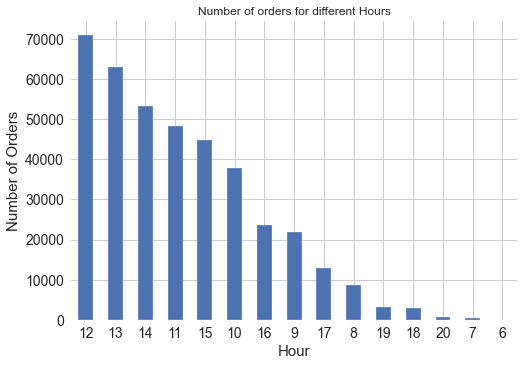

In [28]:
ax = df.Hour.value_counts().plot(kind='bar',title='Number of orders for different Hours',fontsize=14)
ax.set_xlabel('Hour',fontsize=15)
ax.set_ylabel('Number of Orders',fontsize=15)
plt.xticks(rotation=0)
plt.show()


### Observation:
 - Huge sales are happening around 12 PM everyday


### Discover patterns for Unit Price

In [29]:
df.UnitPrice.describe()

count    392732.000000
mean          3.125596
std          22.240725
min           0.000000
25%           1.250000
50%           1.950000
75%           3.750000
max        8142.750000
Name: UnitPrice, dtype: float64

We see that there are unit price = 0 (FREE items)

There are some free items given to customers from time to time.

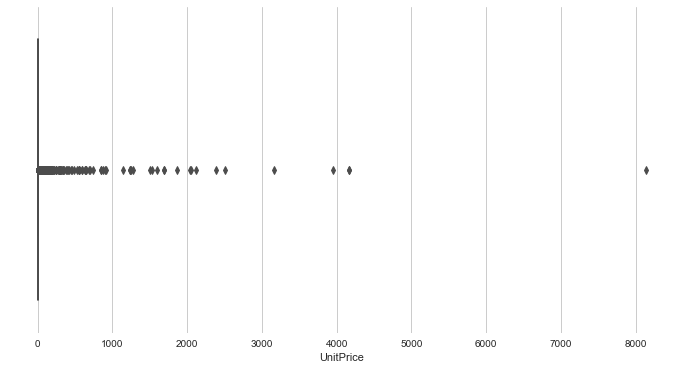

In [30]:
# check the distribution of unit price
plt.subplots(figsize=(12,6))
sns.boxplot(df.UnitPrice)
plt.show()

In [31]:
# Plotting InvoiceNo distribution per Country     https://plotly.com/python/histograms/

top = px.histogram(df, x = 'Country', color = 'Country',
                   title='Distribuition of purchases in the website according to Countries').update_xaxes(categoryorder='total descending')
top.show()

In [32]:
temp = df[['CustomerID', 'InvoiceNo', 'Country']].groupby(['CustomerID', 'InvoiceNo', 'Country']).count()
temp = temp.reset_index(drop = False)
countries = temp['Country'].value_counts()
print('Nb. de pays dans le dataframe: {}'.format(len(countries)))

Nb. de pays dans le dataframe: 37


In [33]:
import plotly.graph_objs as go
from plotly.offline import init_notebook_mode,iplot

# plot map Number of orders per country: 

scl = 'rainbow'
data = dict(type='choropleth',
locations = countries.index,
locationmode = 'country names', z = countries,
text = countries.index, colorbar = {'title':'Order nb.'},
colorscale= scl ,    
reversescale = False)


layout = dict(title='Number of orders per country :',
geo = dict(showframe = True, projection={'type':'mercator'}))


choromap = go.Figure(data = [data], layout = layout)
iplot(choromap, validate=False)

As we see that the dataset is largely dominated by orders made from the UK.

In [34]:
# pandas dataframe :
pd.DataFrame([{'products': len(df['CustomerID'].value_counts()),    
               'transactions': len(df['InvoiceNo'].value_counts()),
               'customers': len(df['CustomerID'].value_counts()),  
              }], columns = ['products', 'transactions', 'customers'], index = ['Quantity'])

,products,transactions,customers
Quantity,4339,18536,4339


In [35]:
uk_ecom = df[df['Country']=='United Kingdom']
uk_ecom['Description'] = uk_ecom['Description'].astype(str)
freq = pd.Series(' '.join(uk_ecom['Description']).split()).value_counts()[:20]
freq

of           35062
set          34281
bag          33304
heart        26985
red          26699
vintage      22739
retrospot    21997
design       20429
pink         17481
christmas    17355
box          15197
white        14851
metal        14737
jumbo        14128
cake         13607
lunch        12708
3            12541
blue         12107
sign         12010
hanging      11952
dtype: int64

Top 5 countries in terms of highest counts of sale/invoices are: UK, Germany, France, Ireland, Spain.
Invoice num 581483 was the largest single order received amounting to 168469.6. Order was placed on 12-9-2011 by a UK customer(16446) with PAPER CRAFT , LITTLE BIRDIE description.
Invoice num 581483 was the largest single order received amounting to 168469.6. Order was placed on 12-9-2011 by a UK customer(16446) with PAPER CRAFT , LITTLE BIRDIE description.

In [36]:
df[df['Amount']==df['Amount'].max()]

,InvoiceNo,StockCode,Year_Month,Month,Day,Hour,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,Amount
540421,581483,23843,201112,12,5,9,"paper craft , little birdie",80995,2011-12-09 09:15:00,2.08,16446,United Kingdom,168469.6


So the invoice num 581483 was the largest order received amounting to 168469.6. Order was placed on 12-9-2011 by a UK customer(16446) with **paper craft , little birdie**	 description.

In [37]:
df[df['CustomerID']==16446.0].sort_values(by='InvoiceDate', ascending=False)

,InvoiceNo,StockCode,Year_Month,Month,Day,Hour,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,Amount
540421,581483,23843,201112,12,5,9,"paper craft , little birdie",80995,2011-12-09 09:15:00,2.08,16446,United Kingdom,168469.60
194355,553573,22982,201105,5,3,9,pantry pastry brush,1,2011-05-18 09:52:00,1.25,16446,United Kingdom,1.25
194354,553573,22980,201105,5,3,9,pantry scrubbing brush,1,2011-05-18 09:52:00,1.65,16446,United Kingdom,1.65


Besides that huge order, this particular customer hasn't placed any significant orders.

### Revenue Plot

In [38]:
revenue_per_countries = df.groupby(["Country"])["Amount"].sum().sort_values()
revenue_per_countries = pd.DataFrame(revenue_per_countries)
revenue_per_countries['percent'] = revenue_per_countries['Amount']/revenue_per_countries['Amount'].sum()*100
revenue_per_countries = revenue_per_countries.sort_values(by=['percent'], ascending=False)
revenue_per_countries = revenue_per_countries.head(15)


In [39]:
revenue_per_countries = revenue_per_countries.reset_index()
top =px.histogram(revenue_per_countries, x ='Country', y ='percent', color = 'Country',
                   title='Distribuition of purchases in the website according to Countries').update_xaxes(categoryorder='total descending')
top.show()

In [40]:
df['Amount']=df['Quantity']*df['UnitPrice']
invoice_customer_df=df.groupby(by=['InvoiceNo','InvoiceDate']).agg({'Amount':sum,'CustomerID':max,'Country':max,}).reset_index()
invoice_customer_df.head()

,InvoiceNo,InvoiceDate,Amount,CustomerID,Country
0,536365,2010-12-01 08:26:00,139.12,17850,United Kingdom
1,536366,2010-12-01 08:28:00,22.20,17850,United Kingdom
2,536367,2010-12-01 08:34:00,278.73,13047,United Kingdom
3,536368,2010-12-01 08:34:00,70.05,13047,United Kingdom
4,536369,2010-12-01 08:35:00,17.85,13047,United Kingdom


### Monthly unique customer

In [41]:
monthly_unique_customer_df=df.set_index('InvoiceDate')['CustomerID'].resample('M').nunique()
monthly_unique_customer_df

monthly_revenue_df=df.set_index('InvoiceDate')['Amount'].resample('M').sum()
monthly_rev_repeat_customer_df=invoice_customer_df.set_index('InvoiceDate').groupby([pd.Grouper(freq='M'),'CustomerID']).filter(lambda x:len(x) > 1).resample('M').sum()['Amount']
monthly_rev_per_repeat_customers_df=monthly_rev_repeat_customer_df/monthly_revenue_df*100
monthly_rev_per_repeat_customers_df

monthly_repeat_customers_df=invoice_customer_df.set_index('InvoiceDate').groupby([pd.Grouper(freq='M'),'CustomerID']).filter(lambda x:len(x)>1).resample('M').nunique()['CustomerID']
monthly_repeat_customers_df

InvoiceDate
2010-12-31    263
2011-01-31    153
2011-02-28    153
2011-03-31    203
2011-04-30    170
2011-05-31    281
2011-06-30    220
2011-07-31    227
2011-08-31    198
2011-09-30    272
2011-10-31    324
2011-11-30    541
2011-12-31    106
Freq: M, Name: CustomerID, dtype: int64

In [42]:
# https://plotly.com/python/pie-charts/

values =  monthly_repeat_customers_df
labels = monthly_repeat_customers_df

# Use `hole` to create a donut-like pie chart
fig = go.Figure(data=[go.Pie(labels=labels, values=values, hole=.3)])
fig.show()

### Plotting the Repeat Revenue Percentage

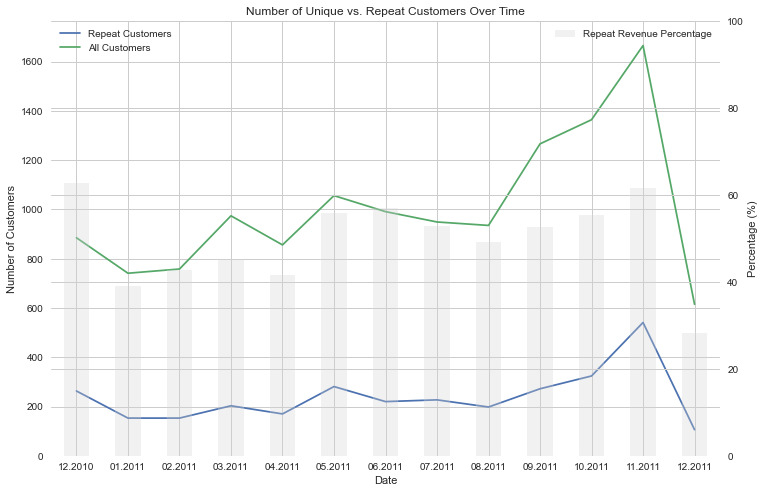

In [43]:
ax=pd.DataFrame(monthly_repeat_customers_df.values).plot(figsize=(12,8))
pd.DataFrame(monthly_unique_customer_df.values).plot(ax=ax,grid=True)
ax2=ax.twinx()
pd.DataFrame(monthly_rev_per_repeat_customers_df.values).plot(ax=ax2,kind='bar',color='lightgrey',alpha=0.3)
ax2.set_ylim([0,max(monthly_rev_per_repeat_customers_df.values)+30])
ax2.set_ylabel('Percentage (%)')
ax2.set_xticklabels([x.strftime('%m.%Y') for x in monthly_rev_per_repeat_customers_df.index])
ax.set_xlabel('Date')
ax.set_ylabel('Number of Customers')
ax.set_title('Number of Unique vs. Repeat Customers Over Time')
ax.legend(['Repeat Customers','All Customers'])
ax2.legend(['Repeat Revenue Percentage'],loc='upper right')
ax.set_ylim([0,monthly_unique_customer_df.values.max()+100])
ax2.set_ylim([0,100])
plt.xticks(range(len(monthly_repeat_customers_df.index)),[x.strftime('%m.%Y') for x in monthly_repeat_customers_df.index],rotation=45)
plt.show()

# 4. Data preparation for modeling

### Calculating RFM metrics

In [44]:
df.head()

,InvoiceNo,StockCode,Year_Month,Month,Day,Hour,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,Amount
299512,563100,POST,201108,8,5,9,postage,6,2011-08-12 09:57:00,40.0,12381,Norway,240.0
224432,556526,POST,201106,6,1,11,postage,1,2011-06-13 11:33:00,18.0,12732,France,18.0
186640,552874,POST,201105,5,4,9,postage,7,2011-05-12 09:40:00,18.0,12621,Germany,126.0
103055,545051,POST,201102,2,7,11,postage,1,2011-02-27 11:58:00,18.0,12599,France,18.0
477044,577046,POST,201111,11,4,13,postage,7,2011-11-17 13:46:00,18.0,12449,Belgium,126.0


**Monetary -** Total or average amount spent by the customer

In [45]:
# Calculating Monetary attribute
cus_data = df.groupby('CustomerID')[['Amount']].sum() # Total amount spent
cus_data.rename(columns={'Amount':'Monetary'},inplace=True)
cus_data.head()

,Monetary
CustomerID,
12346,77183.60
12347,4310.00
12348,1797.24
12349,1757.55
12350,334.40


**Frequency -** Total number of transactions made by customer or average time between transactions.

In [46]:
# Calculating frequency attribute
cus_data['Frequency'] = df.groupby('CustomerID')['InvoiceNo'].count()
cus_data.head()

,Monetary,Frequency
CustomerID,,
12346,77183.60,1
12347,4310.00,182
12348,1797.24,31
12349,1757.55,73
12350,334.40,17


**Recency -** Time since last order or engaged with product.

In [47]:
max_date = max(df['InvoiceDate'])
max_date

Timestamp('2011-12-09 12:50:00')

In [48]:
df['diff'] = max_date - df['InvoiceDate']
df.head()

,InvoiceNo,StockCode,Year_Month,Month,Day,Hour,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,Amount,diff
299512,563100,POST,201108,8,5,9,postage,6,2011-08-12 09:57:00,40.0,12381,Norway,240.0,119 days 02:53:00
224432,556526,POST,201106,6,1,11,postage,1,2011-06-13 11:33:00,18.0,12732,France,18.0,179 days 01:17:00
186640,552874,POST,201105,5,4,9,postage,7,2011-05-12 09:40:00,18.0,12621,Germany,126.0,211 days 03:10:00
103055,545051,POST,201102,2,7,11,postage,1,2011-02-27 11:58:00,18.0,12599,France,18.0,285 days 00:52:00
477044,577046,POST,201111,11,4,13,postage,7,2011-11-17 13:46:00,18.0,12449,Belgium,126.0,21 days 23:04:00


In [49]:
import datetime as dt

cus_data['Recency'] = df.groupby('CustomerID')['diff'].min().dt.days
cus_data = cus_data.reset_index()
cus_data.head()

,CustomerID,Monetary,Frequency,Recency
0,12346,77183.60,1,325
1,12347,4310.00,182,1
2,12348,1797.24,31,74
3,12349,1757.55,73,18
4,12350,334.40,17,309


##  Treating Outliers

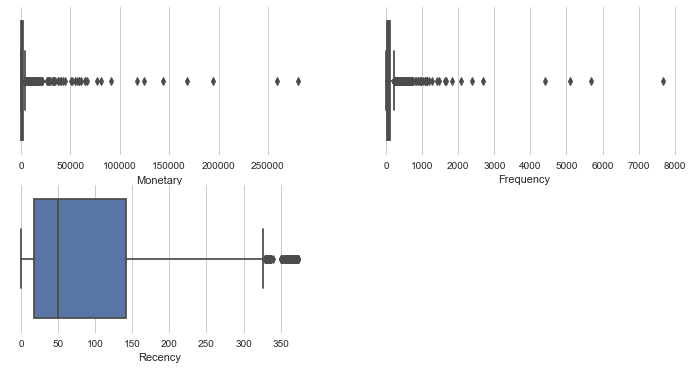

In [50]:
num_features = cus_data.columns[1:]
r = c = 0
fig,ax = plt.subplots(2,2,figsize=(12,6))

for n,i in enumerate(num_features):
    sns.boxplot(x=i, data=cus_data,ax=ax[r,c])
    c+=1
    if (n+1)%2==0:
        r+=1
        c=0
ax[r,c].axis("off")
plt.show()

Based on the above box plots, it's visible that Monetary and Frequency attributes have outliers. Since clustering algorithms like K-means are susceptible to outliers we will be treating them by capping them at 95% quantile.

In [51]:
h_cap = 0.95
h_cap_val = cus_data['Monetary'].quantile(h_cap)
cus_data['Monetary'][cus_data['Monetary'] > h_cap_val] = h_cap_val
l_cap = 0.05
l_cap_val = cus_data['Monetary'].quantile(l_cap)
cus_data['Monetary'][cus_data['Monetary'] < l_cap_val] = l_cap_val

In [52]:
cap = 0.95
cap_val = cus_data['Frequency'].quantile(cap)
cus_data['Frequency'][cus_data['Frequency'] > cap_val] = cap_val

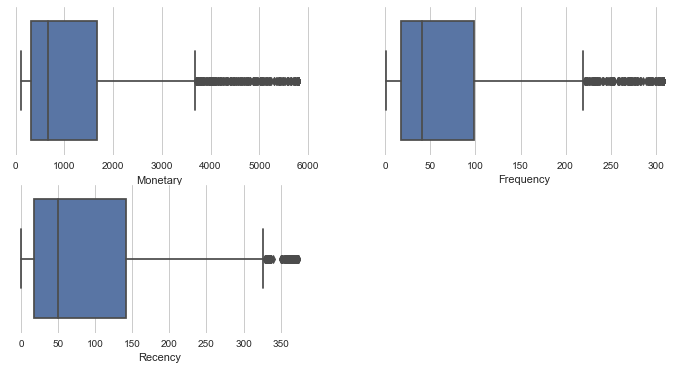

In [53]:
num_features = cus_data.columns[1:]
r = c = 0
fig,ax = plt.subplots(2,2,figsize=(12,6))

for n,i in enumerate(num_features):
    sns.boxplot(x=i, data=cus_data,ax=ax[r,c])
    c+=1
    if (n+1)%2==0:
        r+=1
        c=0
ax[r,c].axis("off")
plt.show()

### Creating pipeline for feature scaling & dimensionality reduction

In [54]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA

preprocessor = Pipeline([("scaler", MinMaxScaler()),
                         ("pca", PCA(n_components=2, random_state=42)),])

In [55]:
X = cus_data.drop('CustomerID',axis=1)
X_scaled = pd.DataFrame(preprocessor.fit_transform(X),columns=['PC_1','PC_2'])

### Hopkins Test
The Hopkins statistic, is a statistic which gives a value which indicates the cluster tendency, in other words: how well the data can be clustered.

If the value is between {0.01, ...,0.3}, the data is regularly spaced.

If the value is around 0.5, it is random.

If the value is between {0.7, ..., 0.99}, it has a high tendency to cluster...

In [56]:
#Calculating the Hopkins statistic
from sklearn.neighbors import NearestNeighbors
from random import sample
from numpy.random import uniform
import numpy as np
from math import isnan
 
def hopkins(X):
    d = X.shape[1]
    #d = len(vars) # columns
    n = len(X) # rows
    m = int(0.1 * n) 
    nbrs = NearestNeighbors(n_neighbors=1).fit(X.values)
 
    rand_X = sample(range(0, n, 1), m)
 
    ujd = []
    wjd = []
    for j in range(0, m):
        u_dist, _ = nbrs.kneighbors(uniform(np.amin(X,axis=0),np.amax(X,axis=0),d).reshape(1, -1), 2, return_distance=True)
        ujd.append(u_dist[0][1])
        w_dist, _ = nbrs.kneighbors(X.iloc[rand_X[j]].values.reshape(1, -1), 2, return_distance=True)
        wjd.append(w_dist[0][1])
 
    H = sum(ujd) / (sum(ujd) + sum(wjd))
    if isnan(H):
        print(ujd, wjd)
        H = 0
 
    return H

In [57]:
for i in range(5):
  print('Hopkins statistic value is:',round(hopkins(X_scaled),3))

Hopkins statistic value is: 0.962
Hopkins statistic value is: 0.957
Hopkins statistic value is: 0.962
Hopkins statistic value is: 0.956
Hopkins statistic value is: 0.958


Since the Hopkins test value hovers around 0.95, therefore given data have high clustering tendency

# 4. Cluster assignment using K-means clustering

### a) Finding Optimal value of K (Clusters)
 - Elbow Method
 - Silhouette Analysis

### Elbow method

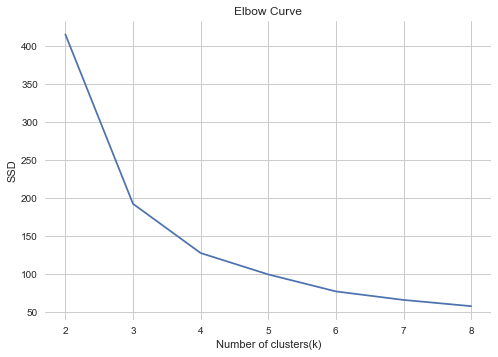

In [58]:
# elbow-curve/SSD
ssd = []
range_n_clusters = [2, 3, 4, 5, 6, 7, 8]
for num_clusters in range_n_clusters:
    kmeans = KMeans(n_clusters=num_clusters, max_iter=50)
    kmeans.fit(X_scaled)
    ssd.append(kmeans.inertia_)

plt.plot(range_n_clusters,ssd)
plt.xlabel('Number of clusters(k)')
plt.ylabel('SSD')
plt.title('Elbow Curve')
plt.show()

Based on above "elbow" curve, k=3 seems to be the optimal number of clusters

### Silhouette Analysis

In [59]:
# silhouette analysis
range_n_clusters = [2, 3, 4, 5, 6, 7, 8]

for num_clusters in range_n_clusters:
    
    # intialise kmeans
    kmeans = KMeans(n_clusters=num_clusters, max_iter=50)
    kmeans.fit(X_scaled)
    
    cluster_labels = kmeans.labels_
    
    # silhouette score
    silhouette_avg = silhouette_score(X_scaled, cluster_labels)
    print("For n_clusters={0}, the silhouette score is {1}".format(num_clusters, round(silhouette_avg,2)))

For n_clusters=2, the silhouette score is 0.54
For n_clusters=3, the silhouette score is 0.55
For n_clusters=4, the silhouette score is 0.52
For n_clusters=5, the silhouette score is 0.48
For n_clusters=6, the silhouette score is 0.46
For n_clusters=7, the silhouette score is 0.43
For n_clusters=8, the silhouette score is 0.41


Using silhouette analysis k=3 seems to be the optimal number of clusters.

## b) Run K-means using optimal K

In [60]:
# final model with k=3
kmeans = KMeans(n_clusters=3, max_iter=50,random_state=1)
kmeans.fit(X_scaled)

KMeans(max_iter=50, n_clusters=3, random_state=1)

In [61]:
# Adding cluster labels to master dataframe
X_scaled['cluster_id'] = kmeans.labels_
X['cluster_id'] = kmeans.labels_

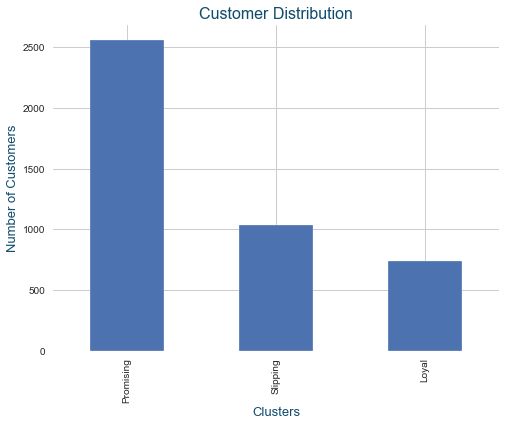

In [62]:
# Number of customers per cluster

font_title = {
        'color':  '#104C6C',
        'weight': 'normal',
        'size': 16,
        }


font_label = {
        'color':  '#104C6C',
        'weight': 'normal',
        'size': 13,
        }
plt.figure(figsize=(8,6))
ax = X_scaled['cluster_id'].value_counts().plot(kind='bar')
ax.set_xticklabels(['Promising','Slipping','Loyal'])
ax.set_ylabel('Number of Customers',font_label)
ax.set_xlabel('Clusters',font_label)
ax.set_title("Customer Distribution",font_title)
plt.show()

## c) Clustering profiling using R-F-M

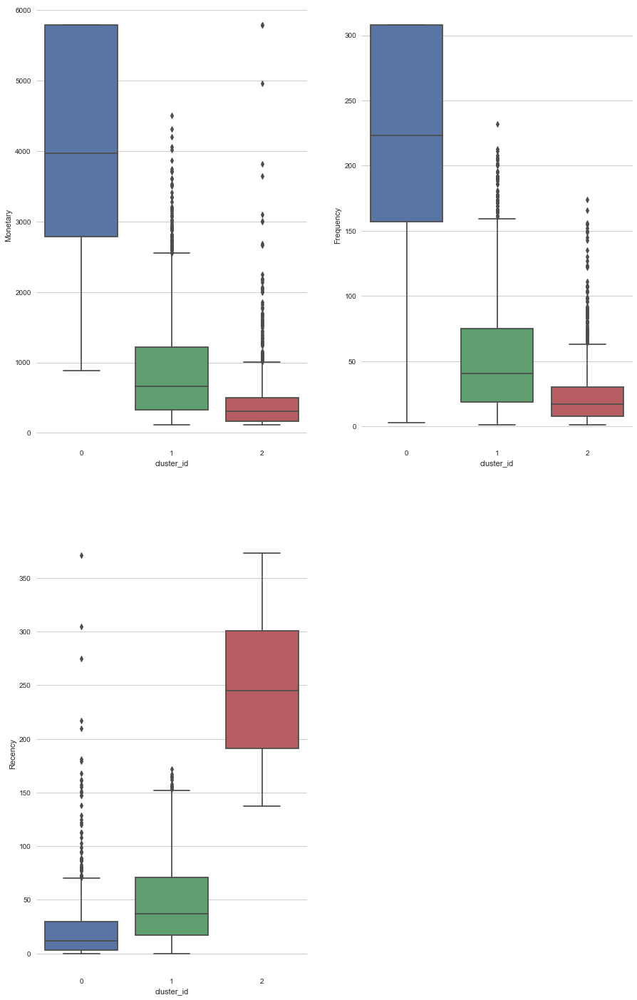

In [63]:
# Visualizing Numerical columns using Boxplots
cols = X.columns[0:-1].tolist()
r = c = 0
fig,ax = plt.subplots(2,2,figsize=(15,25))

for n,i in enumerate(cols):
    sns.boxplot(x='cluster_id',y=cols[n], data=X,ax=ax[r,c])
    c+=1
    if (n+1)%2==0:
        r+=1
        c=0
ax[r,c].axis("off")
plt.show()

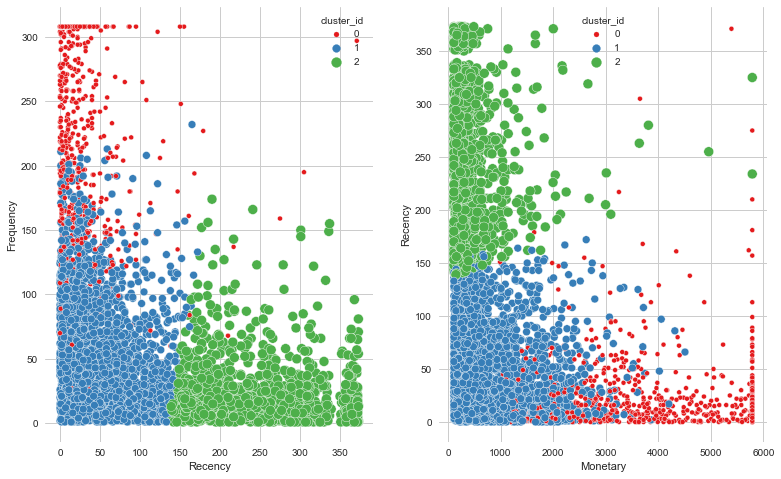

In [64]:
fig = plt.figure(figsize=[20,8])

plt.subplot(1,3,1)
sns.scatterplot(data=X,x="Recency",y="Frequency",hue="cluster_id",size="cluster_id",palette="Set1")
plt.subplot(1,3,2)
'''sns.scatterplot(data=X,x="Frequency",y="Monetary",hue="cluster_id",size="cluster_id",palette="Set1")
plt.subplot(1,3,3)'''
sns.scatterplot(data=X,x="Monetary",y="Recency",hue="cluster_id",size="cluster_id",palette="Set1")
plt.show()

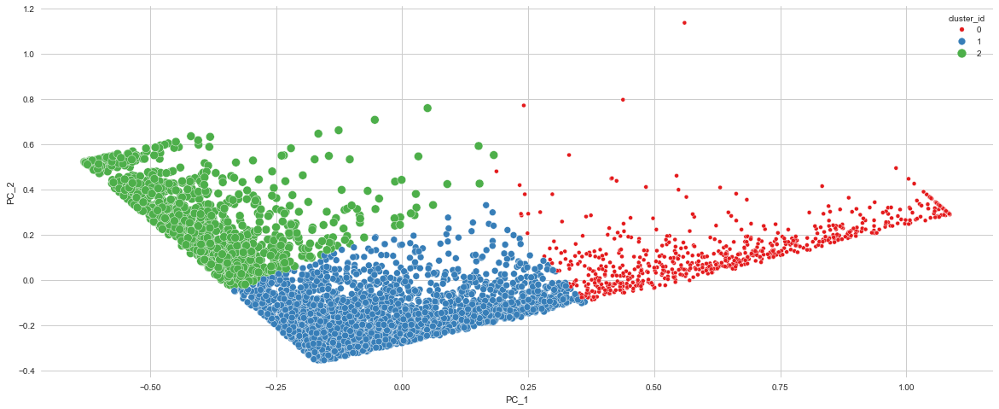

In [65]:
# Vusializing clusters using Principle Components
fig = plt.figure(figsize=[20,8])

sns.scatterplot(data=X_scaled,x="PC_1",y="PC_2",hue="cluster_id",size="cluster_id",palette="Set1")
plt.show()

#### **Inference:**

1. **Cluster 0** contains the customers who generate the least revenue and are not frequent, most likely because these were one-time customers. Hence they can be labeled as **Slipping**.</br>
2. **Cluster 1** seems to have the most **loyal** customers, as they bring the most revenue and are often the most frequent customers.</br>
3. **Cluster 2** customers seem **promising** as it consists of frequent buyers, however revenue generation is not as high as Loyal customers.

<h3> Cluster Labels:</h3>

Cluster 0 - Slipping</br>
Cluster 1 - Loyal</br>
Cluster 2 - Promising</br>

# 5. Recommendations
After segmenting customers into loyal, slipping, and promising it empowers businesses to run personalized, high-performing campaigns and preserves profit margin. Below are a few recommendations or targeted strategies for each customer segment:

 - **Loyal -** Loyalty programs are effective for these repeat visitors. Advocacy programs and reviews are also common X1X strategies. Lastly, consider rewarding these customers with Free Shipping or other like benefits.
 

 - **Promising -** Focus on increasing monetization through product recommendations based on past purchases and incentives tied to spending thresholds.
 

 - **Slipping -** Customers leave for a variety of reasons. Depending on your situation price deals, new product launches, or other retention strategies.